In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import matplotlib.patheffects as path_effects


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects
import regex as re
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

# Model selection and metrics librarys 
from sklearn.model_selection import StratifiedKFold,cross_val_score,cross_val_predict,train_test_split,RandomizedSearchCV, GridSearchCV,learning_curve
from sklearn.metrics import precision_recall_curve,accuracy_score,confusion_matrix,ConfusionMatrixDisplay,mean_absolute_error,mean_squared_error,roc_auc_score,roc_curve
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

from sklearn.preprocessing import OneHotEncoder
# Some Machine Learning Models
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
import lightgbm as lgb  
from sklearn.ensemble import AdaBoostClassifier,BaggingClassifier,ExtraTreesClassifier,GradientBoostingClassifier,HistGradientBoostingClassifier,RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from catboost import CatBoostClassifier
from catboost import Pool,CatBoostClassifier
from sklearn.model_selection import RepeatedKFold

In [3]:
import pyodbc

# Establish a connection to the SQL Server database
conn = pyodbc.connect(
    'Driver={SQL Server};'
    'Server=DESKTOP-SL9077G\SQLEXPRESS;'
    'Database=lavadb;'
)



In [4]:
# Create a cursor object
cursor = conn.cursor()

# Execute a SQL query
cursor.execute('SELECT * FROM machinefailure')

# Fetch the results
data = cursor.fetchall()

# Iterate over the rows
for row in data:
    # Access the data in each row using column names
    column1_value = row.Date
    column2_value = row.Machine_ID
    column3_value = row.Assembly_Line_No
    column4_value = row.HyPr
    column5_value = row.CooPr
    column6_value = row.AirPr
    column7_value = row.CooTemp
    column8_value = row.HyTemp
    column9_value = row.SpTemp
    column10_value = row.SpVib
    column11_value = row.ToolVib
    column12_value = row.SpSpeed
    column13_value = row.Volt
    column14_value = row.Torque_Nm
    column15_value = row.Cutting
    column16_value = row.Downtime
    # ... perform further processing with the values


In [5]:
# Create a cursor object
cursor = conn.cursor()

# Execute a SQL query
cursor.execute('SELECT * FROM machinefailure')

# Fetch the results
data = cursor.fetchall()

# Iterate over the rows
for row in data:
    # Access the data in each row using index positions
    column1_value = row[0]  # Date
    column2_value = row[1]  # Machine_ID
    column3_value = row[2]  # Assembly_Line_No
    column4_value = row[3]  # Hydraulic_Pressure(bar)
    column5_value = row[4]  # Coolant_Pressure(bar)
    column6_value = row[5]  # Air_System_Pressure(bar)
    column7_value = row[6]  # Coolant_Temperature(°C)
    column8_value = row[7]  # Hydraulic_Oil_Temperature(°C)
    column9_value = row[8]  # Spindle_Bearing_Temperature(°C)
    column10_value = row[9]  # Spindle_Vibration(µm)
    column11_value = row[10]  # Tool_Vibration(µm)
    column12_value = row[11]  # Spindle_Speed(RPM)
    column13_value = row[12]  # Voltage(volts)
    column14_value = row[13]  # Torque(Nm)
    column15_value = row[14]  # Cutting(kN)
    column16_value = row[15]  # Downtime
    # ... perform further processing with the values


In [6]:
# Get the column names
columns = [column[0] for column in cursor.description]


In [7]:
# Create a DataFrame from the fetched data
df = pd.DataFrame.from_records(data, columns=columns)

In [8]:
df.shape

(2500, 16)

In [9]:
# Access and manipulate the data in the DataFrame
print(df.head())  # Print the first few rows of the DataFrame

                          Date            Machine_ID Assembly_Line_No    HyPr  \
0  2021-12-31 00:00:00.0000000  Makino-L1-Unit1-2013     Shopfloor-L1   71.04   
1  2021-12-31 00:00:00.0000000  Makino-L1-Unit1-2013     Shopfloor-L1     NaN   
2  2021-12-31 00:00:00.0000000  Makino-L3-Unit1-2015     Shopfloor-L3   71.12   
3  2022-05-31 00:00:00.0000000  Makino-L2-Unit1-2015     Shopfloor-L2  139.34   
4  2022-03-31 00:00:00.0000000  Makino-L1-Unit1-2013     Shopfloor-L1   60.51   

      CooPr     AirPr  CooTemp  HyTemp  SpTemp  SpVib  ToolVib  SpSpeed  \
0  6.933725  6.284965     25.6    46.0    33.4  1.291   26.492  25892.0   
1  4.936892  6.196733     35.3    47.4    34.6  1.382   25.274  19856.0   
2  6.839413  6.655448     13.1    40.7    33.0  1.319   30.608  19851.0   
3  4.574382  6.560394     24.4    44.2    40.6  0.618   30.791  18461.0   
4  6.893182  6.141238      4.1    47.3    31.4  0.983   25.516  26526.0   

    Volt  Torque_Nm  Cutting         Downtime  
0  335.0  24.0

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Date              2500 non-null   object 
 1   Machine_ID        2500 non-null   object 
 2   Assembly_Line_No  2500 non-null   object 
 3   HyPr              2489 non-null   float64
 4   CooPr             2480 non-null   float64
 5   AirPr             2481 non-null   float64
 6   CooTemp           2488 non-null   float64
 7   HyTemp            2483 non-null   float64
 8   SpTemp            2491 non-null   float64
 9   SpVib             2489 non-null   float64
 10  ToolVib           2489 non-null   float64
 11  SpSpeed           2492 non-null   float64
 12  Volt              2494 non-null   float64
 13  Torque_Nm         2474 non-null   float64
 14  Cutting           2493 non-null   float64
 15  Downtime          2500 non-null   object 
dtypes: float64(12), object(4)
memory usage: 31

In [11]:
df = df.drop(columns=['Date'])

df = df.drop(columns=['Assembly_Line_No'])

In [12]:
def info_df(df):
    nan_count = df.isna().sum() # Number of Null Values
    nan_perc= (nan_count / df.shape[0]) * 100 # Prec of Null Values
    dtype_df = df.dtypes # types for each col
    num_dup = df.apply(lambda x : x.duplicated().sum()) # Number of Duplicated in each col
    num_uni = df.apply(lambda x : len(x.unique())) # Number of unique values in each col
     
    info_data = pd.concat([nan_count,nan_perc,dtype_df,num_dup,num_uni],axis = 1).reset_index() #Now we concat all of them
    info_data.rename(columns = {0 : 'NaN Count' , 1:'Nan Perc',2:'Dtype',3:'num_dup',4:'num_uniq'},inplace= True) # just rename
    return info_data

In [13]:
info_df(df).style.background_gradient()

,index,NaN Count,Nan Perc,Dtype,num_dup,num_uniq
0,Machine_ID,0,0.000000,object,2497,3
1,HyPr,11,0.440000,float64,532,1968
2,CooPr,20,0.800000,float64,875,1625
3,AirPr,19,0.760000,float64,41,2459
4,CooTemp,12,0.480000,float64,2225,275
5,HyTemp,17,0.680000,float64,2289,211
6,SpTemp,9,0.360000,float64,2295,205
7,SpVib,11,0.440000,float64,1360,1140
8,ToolVib,11,0.440000,float64,158,2342
9,SpSpeed,8,0.320000,float64,1325,1175


In [14]:
# Some statistical Info
print(50 * '#')
print(f'info {df.info()}')        #print the label "info" in between the lines of "#" characters
print(50 * '#')
df.describe().style.background_gradient()           #calculates and displays the descriptive statistics of the DataFrame

##################################################
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 14 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Machine_ID  2500 non-null   object 
 1   HyPr        2489 non-null   float64
 2   CooPr       2480 non-null   float64
 3   AirPr       2481 non-null   float64
 4   CooTemp     2488 non-null   float64
 5   HyTemp      2483 non-null   float64
 6   SpTemp      2491 non-null   float64
 7   SpVib       2489 non-null   float64
 8   ToolVib     2489 non-null   float64
 9   SpSpeed     2492 non-null   float64
 10  Volt        2494 non-null   float64
 11  Torque_Nm   2474 non-null   float64
 12  Cutting     2493 non-null   float64
 13  Downtime    2500 non-null   object 
dtypes: float64(12), object(2)
memory usage: 273.6+ KB
info None
##################################################


,HyPr,CooPr,AirPr,CooTemp,HyTemp,SpTemp,SpVib,ToolVib,SpSpeed,Volt,Torque_Nm,Cutting
count,2489.000000,2480.000000,2481.000000,2488.000000,2483.000000,2491.000000,2489.000000,2489.000000,2492.000000,2494.000000,2474.000000,2493.000000
mean,101.755068,4.947761,6.499501,18.571543,47.677567,35.062585,1.009853,25.406282,20272.032504,349.009623,25.254886,2.783133
std,35.209227,0.996581,0.407806,8.562704,4.849315,3.768890,0.341722,6.440711,3853.271461,45.448691,6.126694,0.616993
min,-14.326454,0.325000,5.063480,4.100000,35.200000,22.600000,0.010000,2.161000,0.000000,202.000000,0.000000,1.800000
25%,76.430000,4.465653,6.216462,10.400000,45.100000,32.500000,0.777000,21.089000,17919.000000,319.000000,21.704037,2.250000
50%,96.690000,4.939238,6.505579,21.200000,47.700000,35.100000,1.008000,25.444000,20137.500000,349.000000,24.666202,2.770000
75%,126.479953,5.514276,6.780685,25.600000,50.100000,37.600000,1.235000,29.773000,22489.750000,380.000000,30.514008,3.270000
max,1000.000000,11.350000,7.973992,98.200000,200.000000,49.500000,2.000000,45.726000,27957.000000,479.000000,55.552400,3.930000


In [15]:
def label_txt(txt,w = 0.4,h = 0.5,font_size = 40,facecolor = '#bde0fe'):
    fig = plt.figure(figsize=(22, 0.8))
    plt.axis('off')


    t = plt.text(w, h,
                txt,
                fontsize = font_size, 
                weight = 1000, 
                va ='center')
    fig.set_facecolor(facecolor)
    # hatch ='xxxx'
    t.set_path_effects([path_effects.PathPatchEffect(offset =(3, -4),
                                                   
                                                    facecolor ='gray'),
                        path_effects.PathPatchEffect(edgecolor ='white', 
                                                    linewidth = 1.1,
                                                    facecolor ='black')])

def cat_ana(col,df,target = None):
    sns.set_context('notebook',font_scale= 1.5)
    plt.rcParams['figure.facecolor'] = 'ghostwhite'
    plt.rcParams['axes.facecolor'] = 'white'
    fig, axs = plt.subplots(1,2,figsize = (25,10))

    g = sns.countplot(x = col,data = df ,order = df[col].value_counts().index,hue = target ,palette="crest", ax = axs[0])
    
    axs[0].set_title(f'Value_counts for {col}')
    g.bar_label(g.containers[0])
    
    plt.pie(df[col].value_counts().values , labels =df[col].value_counts().index 
            , shadow = True , autopct= '%1.1f%%', wedgeprops= {'edgecolor' : 'black'} )
    plt.grid()
    plt.tight_layout()
    plt.show()
    
def cat_count(col,df,target,title):
    plt.figure(figsize=(20,10))
    g = sns.countplot(y = col,data = df ,order = df[col].value_counts().index,hue = target ,palette="crest")
    
    g.set_title(title)
    g.legend(loc='lower right')
    for i in range(len(df_train['Type'].value_counts())):
        plt.bar_label(g.containers[i])

        
def hist_df(row,col,df,hue = None):


    fig, axes = plt.subplots(row,col,figsize = (25,10))

    nu_col = 0

    for i in range(row):
        for c in range(col):
            g = sns.histplot(x = num_feature[nu_col],data = df,hue  = hue ,ax = axes[i][c],kde=True)
            nu_col+=1
    plt.tight_layout()
    plt.show()

    
def scatter_df(x,y,df,hue = None,markers = None):
    plt.figure(figsize=(20,10))
    sns.scatterplot(x=  x,y = y,data = df,hue = hue ,style=hue)
    plt.title(f"{x} vs {y}")
    plt.tight_layout()
    plt.show()
    
def hist_box(x,df,hue = None):
    
    fig, axes = plt.subplots(1,2,figsize = (30,12))
    
    sns.histplot(x = x,data = df,hue  = hue ,ax = axes[0],kde=True)
    sns.boxplot(x = hue,y = x,data = df ,ax = axes[1])
    fig.suptitle(f"{x} col Dist")

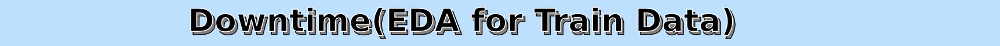

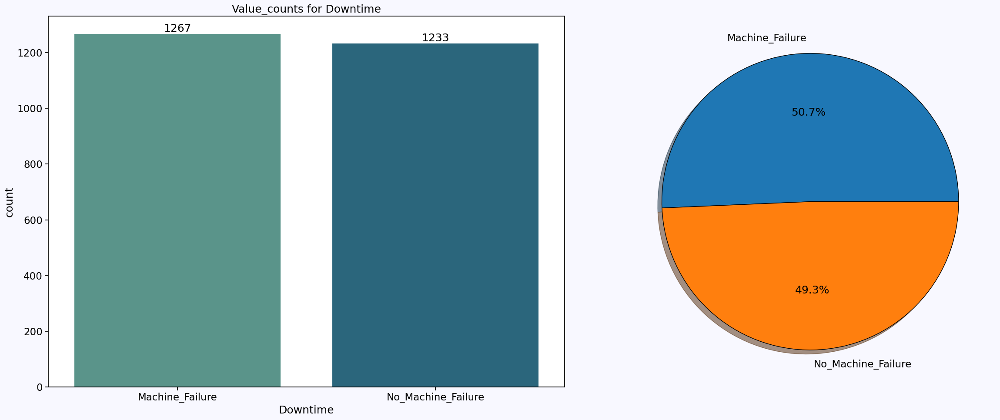

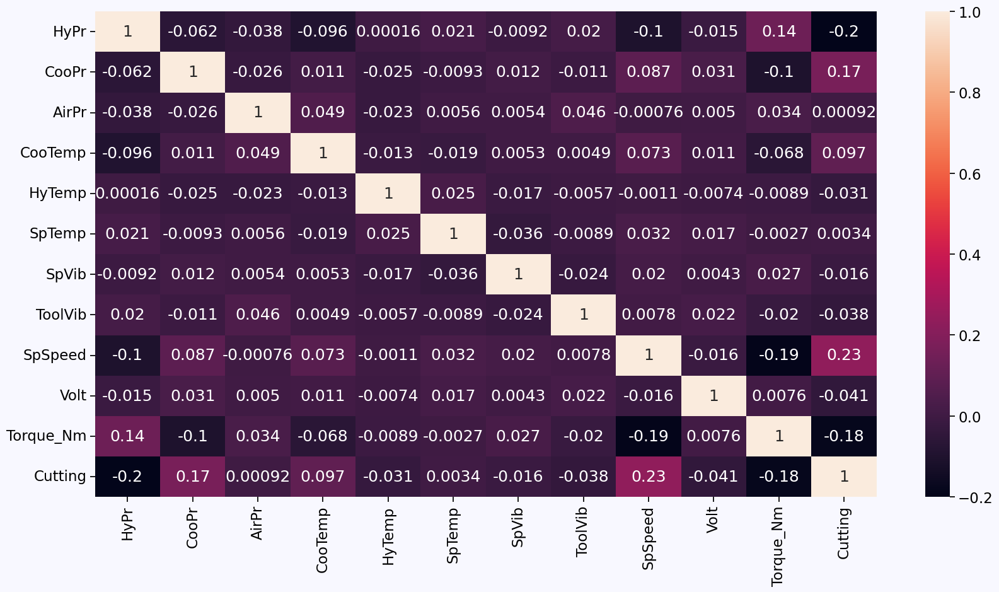

<Figure size 2000x1000 with 0 Axes>

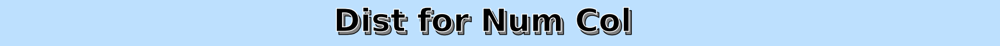

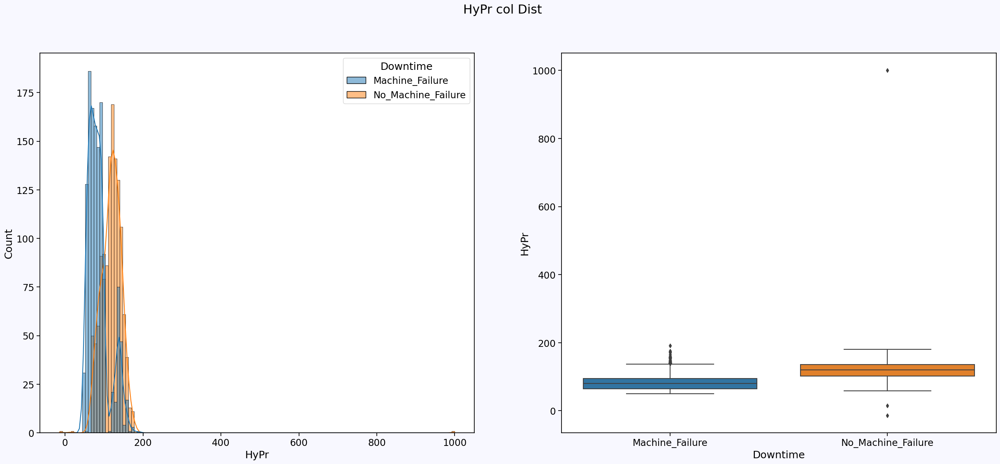

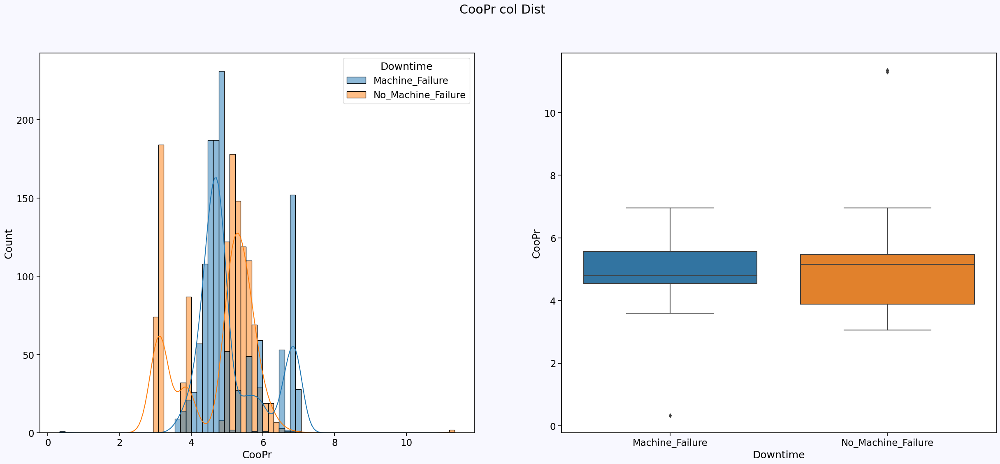

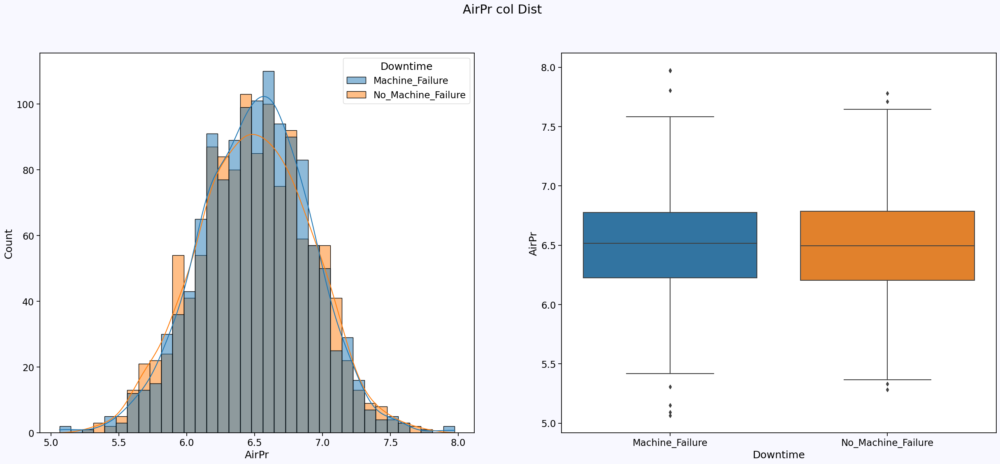

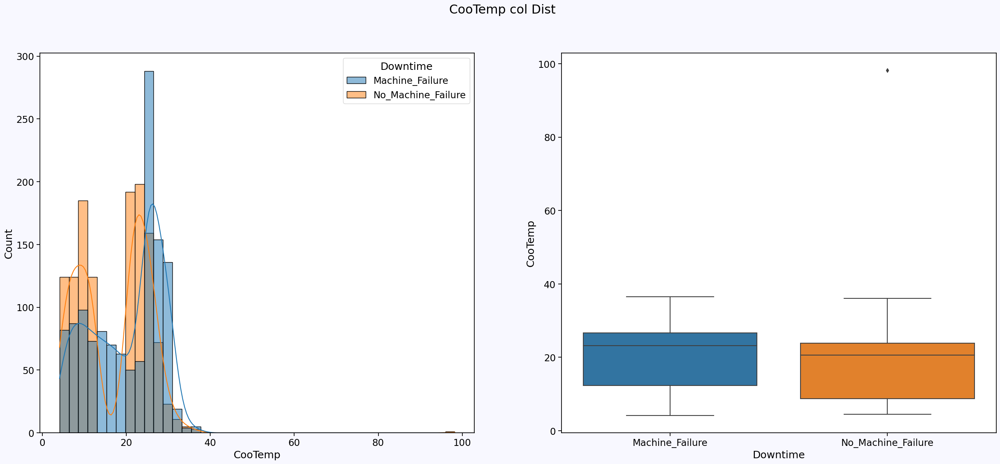

...

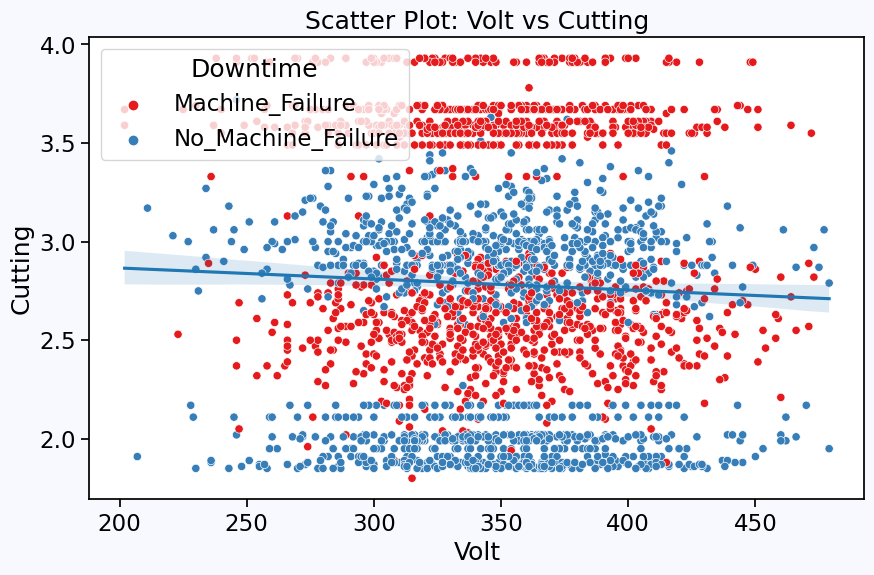

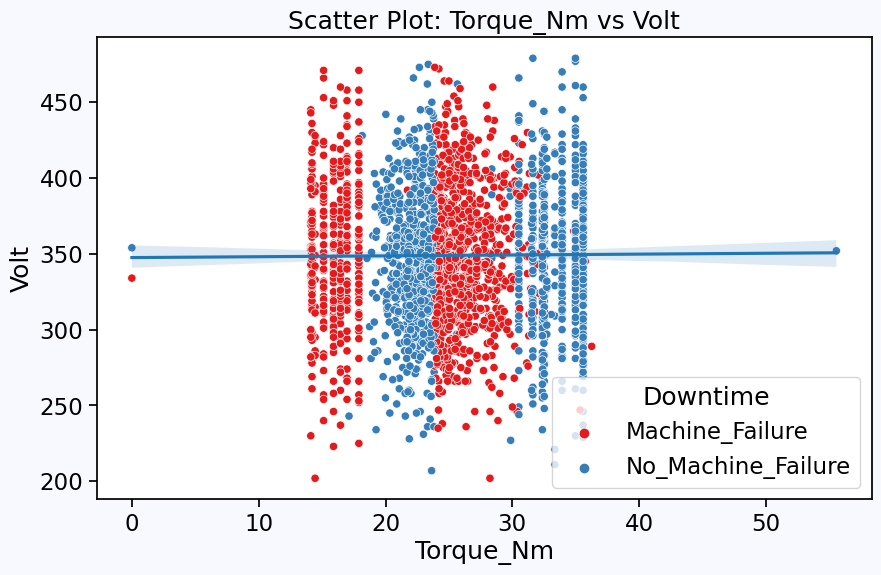

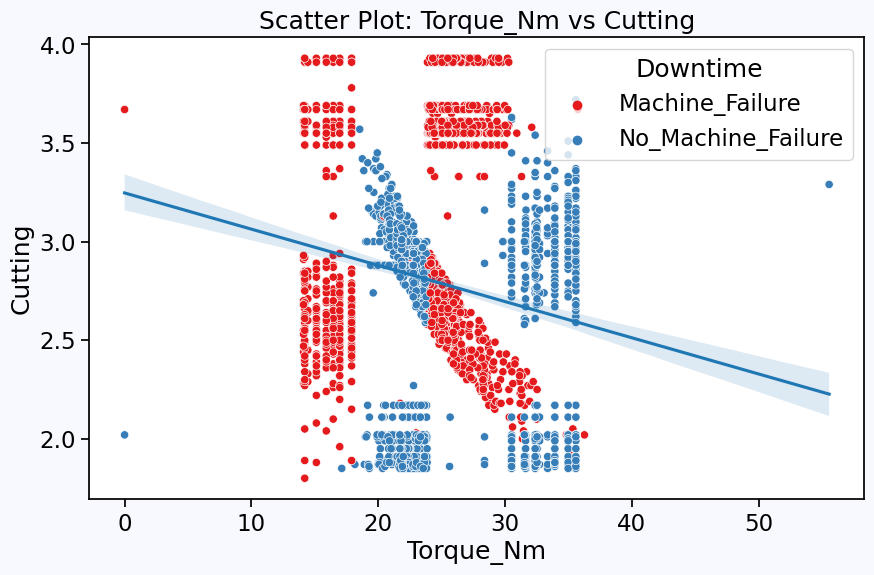

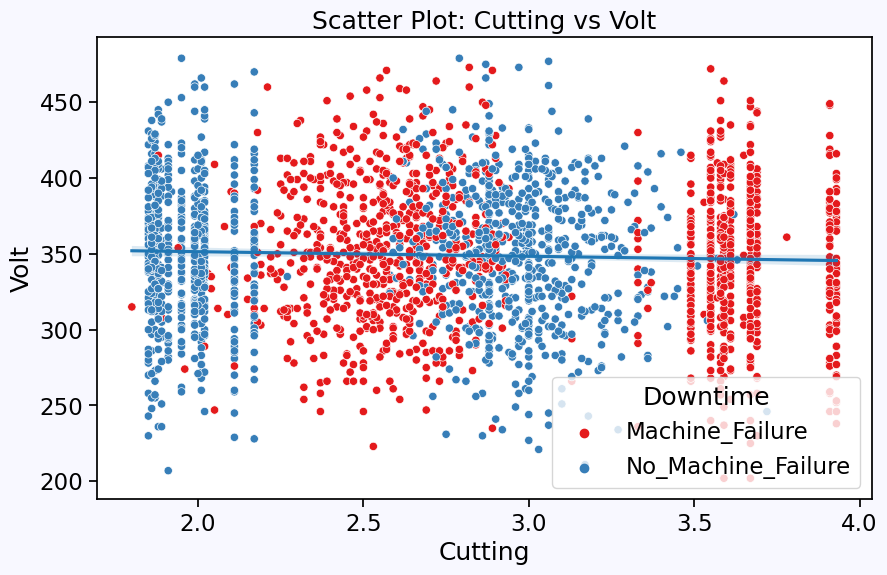

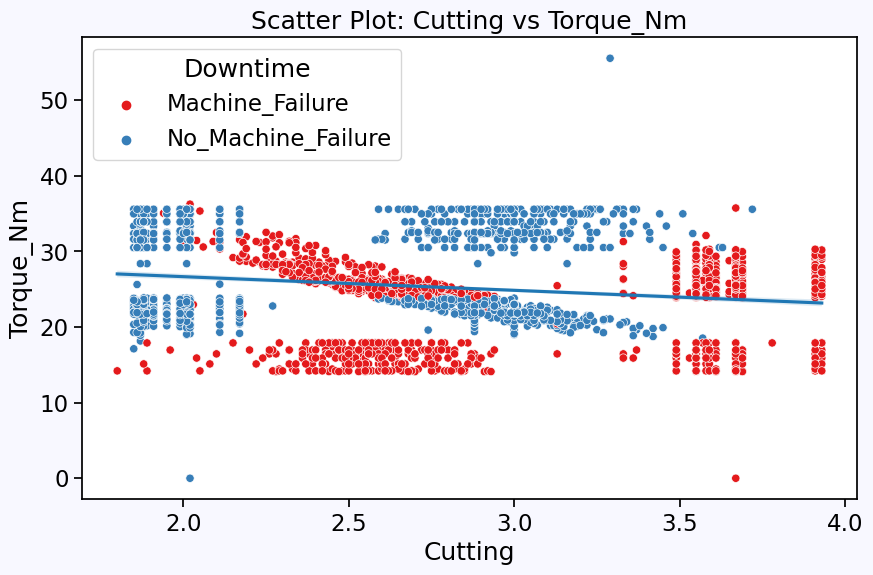

In [16]:

label_txt(f'   Downtime(EDA for Train Data)',w = 0.15)

cat_ana('Downtime',df)

plt.figure(figsize=(20,10))
sns.heatmap(df.corr(),annot = True)
plt.figure(figsize=(20,10))

def cat_count(col, df, hue, title):
    plt.figure(figsize=(20, 10))
    g = sns.countplot(y=col, data=df, order=df[col].value_counts().index, hue=hue, palette="crest")
    g.set_title(title)
    g.legend(loc='lower right')
    for i in range(len(df[col].value_counts())):
        plt.bar_label(g.containers[i])



label_txt(f'                Dist for Num Col',w = 0.15)

#hist_df(3,2,df_train,"Machine failure")
num_feature= ['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib',
       'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']
for feature in num_feature:
    hist_box(feature, df, 'Downtime')


def scatter_df(x_col, y_col, df, hue=None):
    plt.figure(figsize=(10, 6))
    scatter_plot = sns.scatterplot(x=x_col, y=y_col, data=df, hue=hue, palette="Set1")
    scatter_plot.set_title(f'Scatter Plot: {x_col} vs {y_col}')
    
    # Add trend line
    sns.regplot(x=x_col, y=y_col, data=df, scatter=False, ax=scatter_plot)
    
    plt.legend(title=hue)
    plt.show()

columns = ['HyPr', 'CooPr', 'AirPr']

# Generate scatter plots with trend lines for various column combinations
for col1 in columns:
    for col2 in columns:
        if col1 != col2:
            scatter_df(col1, col2, df, hue='Downtime')
            
Column_2 = ['CooTemp', 'HyTemp', 'SpTemp']

for col1 in Column_2:
    for col2 in Column_2:
        if col1 != col2:
            scatter_df(col1, col2, df, hue='Downtime')


Column_3 = ['SpVib', 'ToolVib', 'SpSpeed']

for col1 in Column_3:
    for col2 in Column_3:
        if col1 != col2:
            scatter_df(col1, col2, df, hue='Downtime')



Column_4 = ['Volt', 'Torque_Nm', 'Cutting']
for col1 in Column_4:
    for col2 in Column_4:
        if col1 != col2:
            scatter_df(col1, col2, df, hue='Downtime')
           

In [17]:
print(df.columns)


Index(['Machine_ID', 'HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting',
       'Downtime'],
      dtype='object')


In [18]:
# Initialize LabelEncoder
label_encoder = LabelEncoder()

# List of columns to encode
columns_to_encode = ['Downtime']

# Apply LabelEncoder to selected columns
for col in columns_to_encode:
    df[col] = label_encoder.fit_transform(df[col])

# Display the encoded DataFrame
print(df)

                Machine_ID        HyPr     CooPr     AirPr  CooTemp  HyTemp  \
0     Makino-L1-Unit1-2013   71.040000  6.933725  6.284965     25.6    46.0   
1     Makino-L1-Unit1-2013         NaN  4.936892  6.196733     35.3    47.4   
2     Makino-L3-Unit1-2015   71.120000  6.839413  6.655448     13.1    40.7   
3     Makino-L2-Unit1-2015  139.340000  4.574382  6.560394     24.4    44.2   
4     Makino-L1-Unit1-2013   60.510000  6.893182  6.141238      4.1    47.3   
...                    ...         ...       ...       ...      ...     ...   
2495  Makino-L1-Unit1-2013  112.715506  5.220885  6.196610     22.3    48.8   
2496  Makino-L1-Unit1-2013  103.086653  5.211886  7.074653     11.9    48.3   
2497  Makino-L2-Unit1-2015  118.643165  5.212991  6.530049      4.5    49.9   
2498  Makino-L3-Unit1-2015  145.855859  5.207777  6.402655     12.2    44.5   
2499  Makino-L2-Unit1-2015   96.690000  5.936610  7.109355     29.8    53.2   

      SpTemp  SpVib  ToolVib  SpSpeed   Volt  Torqu

In [19]:
# Access the mapping between original values and numerical labels
for col in columns_to_encode:
    mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))
    print(f"Mapping for '{col}': {mapping}")

Mapping for 'Downtime': {'Machine_Failure': 0, 'No_Machine_Failure': 1}


<AxesSubplot:>

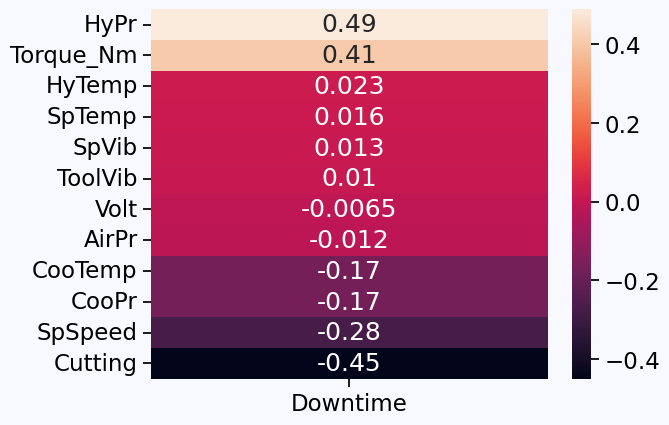

In [20]:
sns.heatmap(df.corr()['Downtime'].drop('Downtime').sort_values(ascending=False).to_frame(),annot = True)

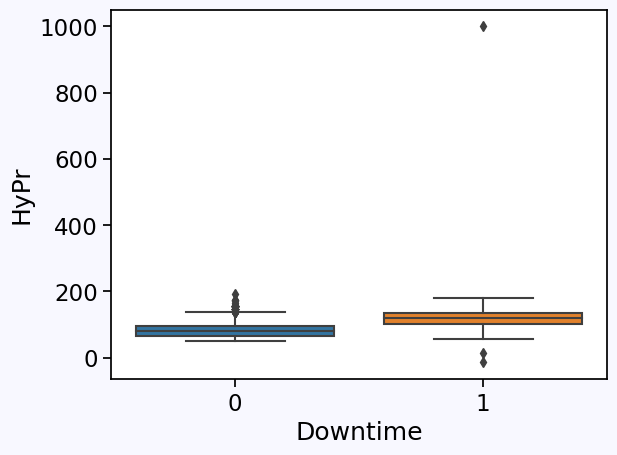

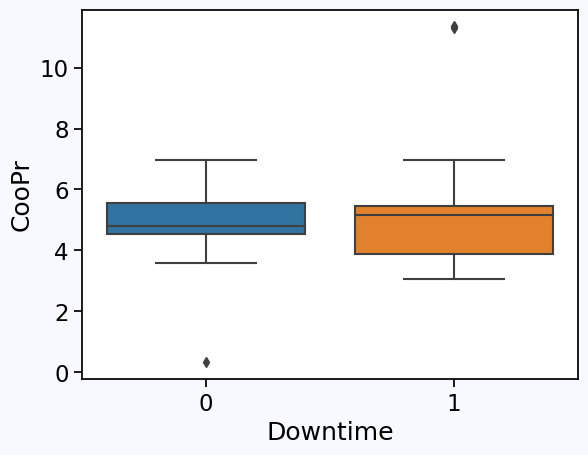

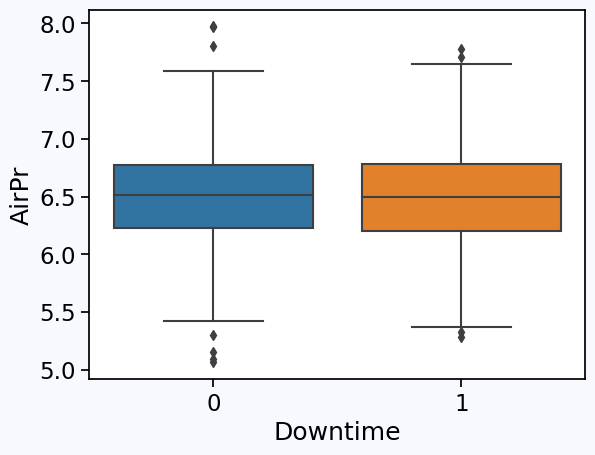

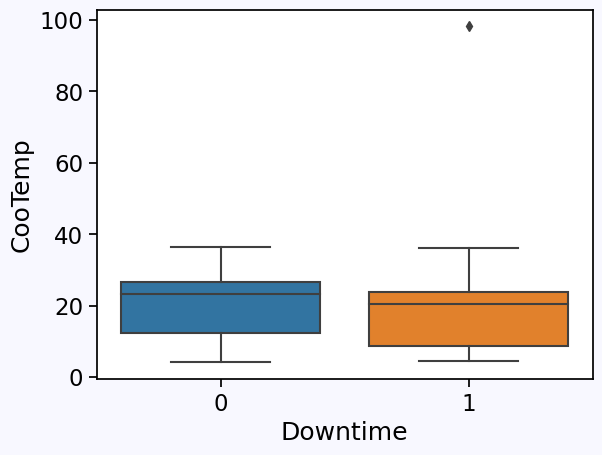

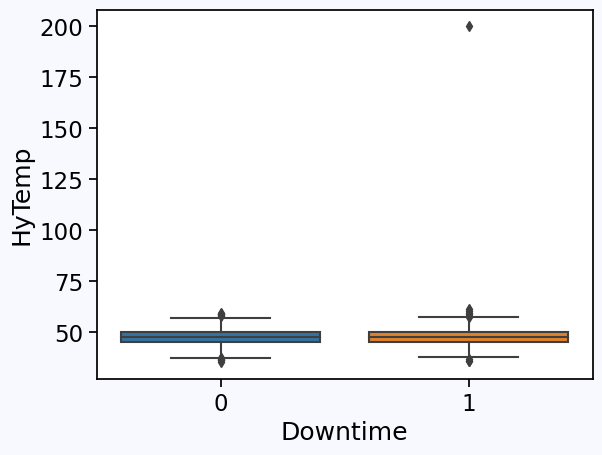

...

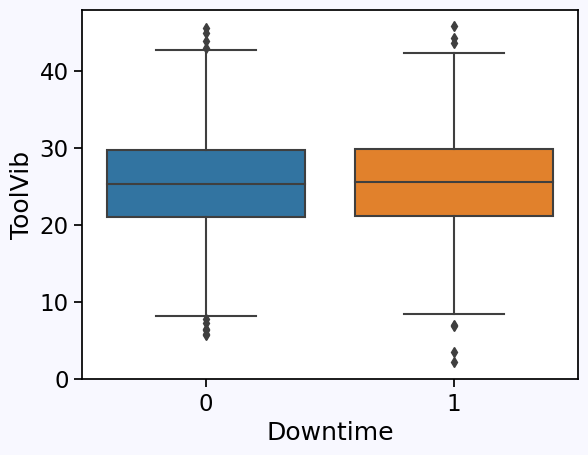

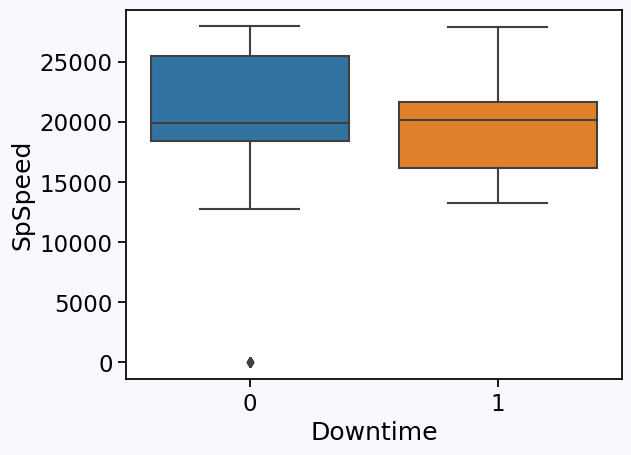

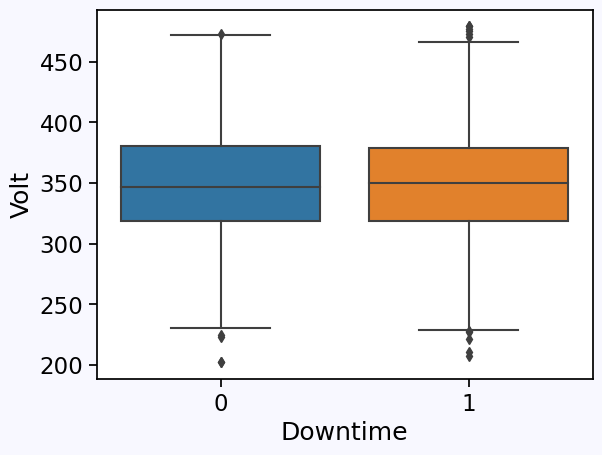

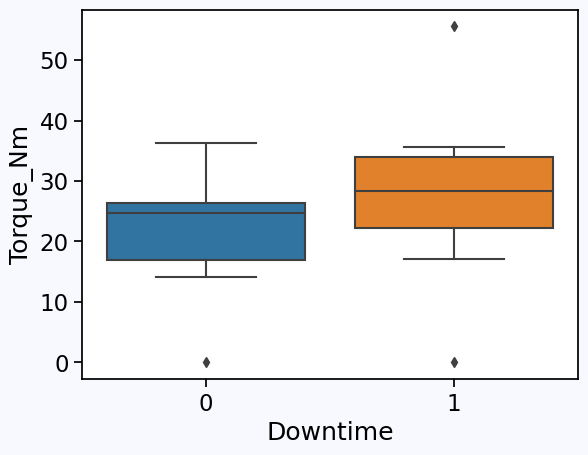

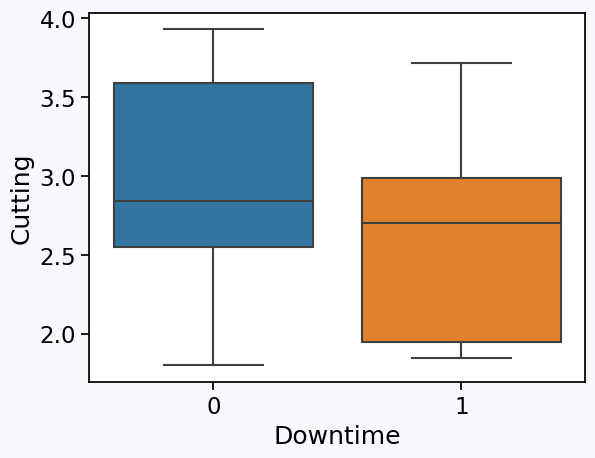

In [21]:
numerical_variables = ['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']

for y in numerical_variables:
    sns.boxplot(y=y,x="Downtime",data=df)
    plt.show()

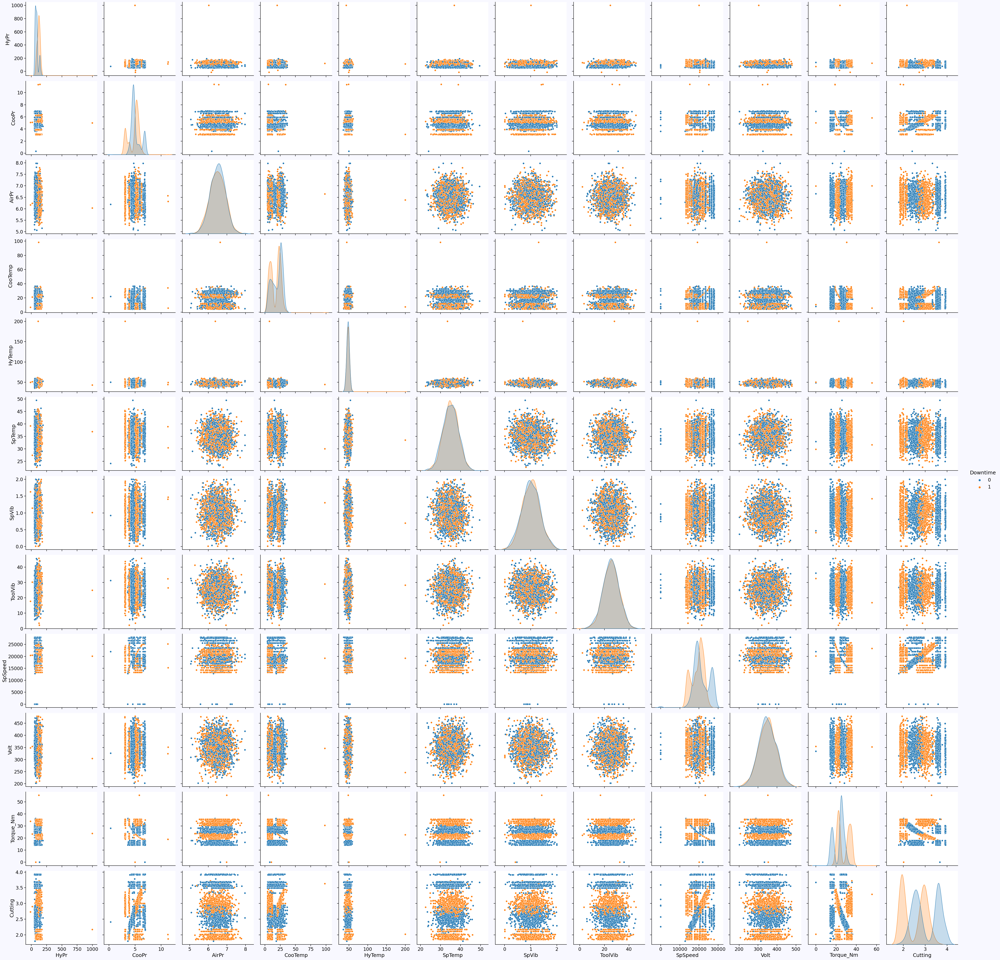

In [22]:
sns.pairplot(df, hue='Downtime', height=4)

In [23]:
correlation_matrix = df[numerical_variables].corr()
print(correlation_matrix)

               HyPr     CooPr     AirPr   CooTemp    HyTemp    SpTemp  \
HyPr       1.000000 -0.062158 -0.037890 -0.095849  0.000158  0.021465   
CooPr     -0.062158  1.000000 -0.026084  0.011269 -0.025366 -0.009332   
AirPr     -0.037890 -0.026084  1.000000  0.049180 -0.023128  0.005560   
CooTemp   -0.095849  0.011269  0.049180  1.000000 -0.012971 -0.018956   
HyTemp     0.000158 -0.025366 -0.023128 -0.012971  1.000000  0.025030   
SpTemp     0.021465 -0.009332  0.005560 -0.018956  0.025030  1.000000   
SpVib     -0.009207  0.012338  0.005366  0.005267 -0.016817 -0.035606   
ToolVib    0.020124 -0.011002  0.046388  0.004879 -0.005692 -0.008856   
SpSpeed   -0.104030  0.087366 -0.000764  0.072954 -0.001099  0.032105   
Volt      -0.014713  0.030963  0.004961  0.010800 -0.007394  0.016587   
Torque_Nm  0.135874 -0.103670  0.033957 -0.068236 -0.008894 -0.002659   
Cutting   -0.200151  0.166494  0.000924  0.096856 -0.030891  0.003407   

              SpVib   ToolVib   SpSpeed      Volt 

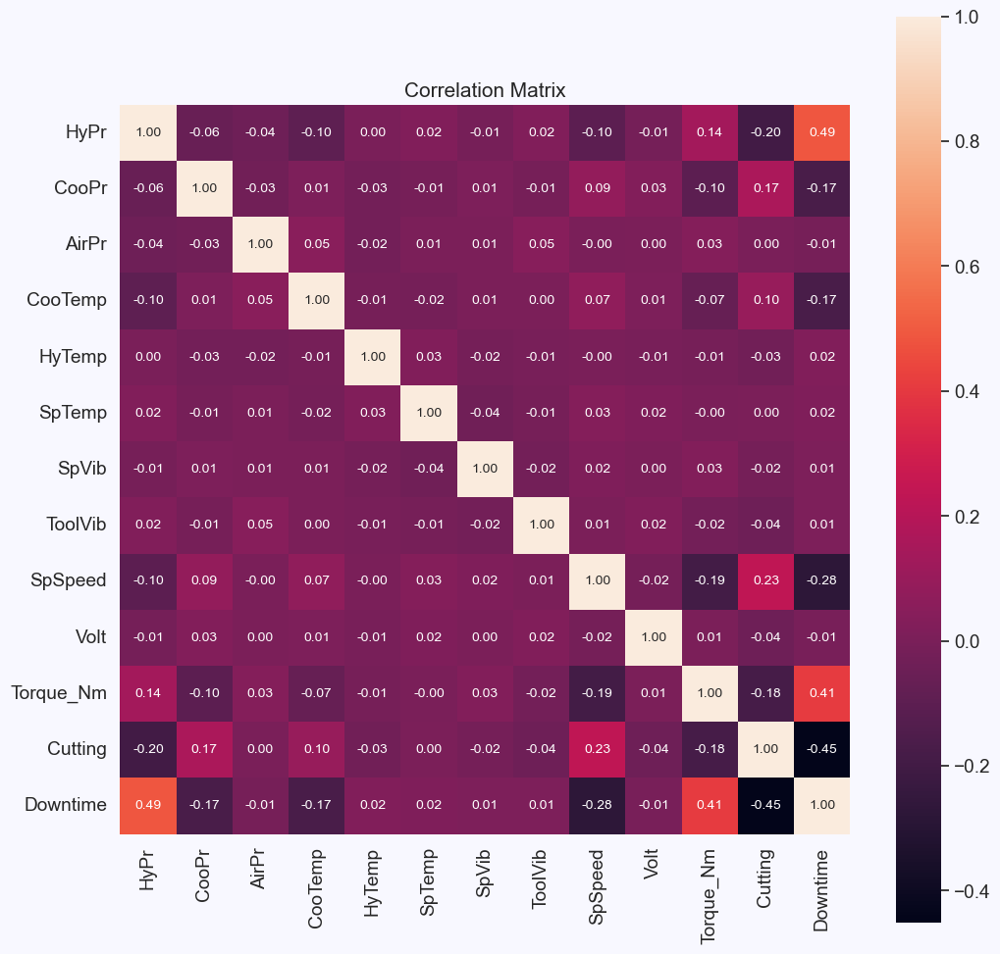

Downtime     1.000000
HyPr         0.489490
Torque_Nm    0.407241
HyTemp       0.022779
SpTemp       0.016389
SpVib        0.013054
ToolVib      0.010290
Volt        -0.006510
AirPr       -0.011957
CooTemp     -0.170177
CooPr       -0.171034
SpSpeed     -0.275013
Cutting     -0.450595
Name: Downtime, dtype: float64

In [24]:
# Calculate correlation matrix
corrmat = df.corr()

# Set up the heatmap
plt.figure(figsize=(12, 12))
sns.set(font_scale=1.25)
hm = sns.heatmap(corrmat, cbar=True, annot=True, square=True, fmt='.2f',
                 annot_kws={'size': 10}, yticklabels=corrmat.columns, xticklabels=corrmat.columns)

plt.title('Correlation Matrix')
plt.show()

corrmat["Downtime"].sort_values(ascending=False)

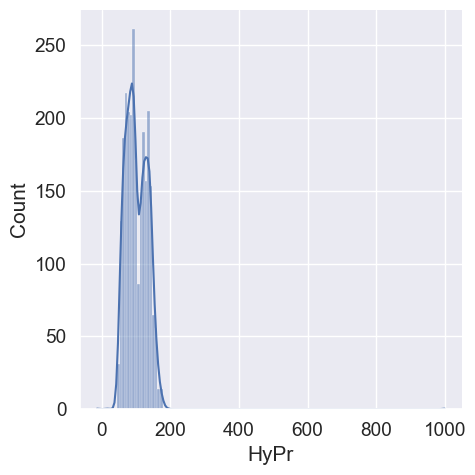

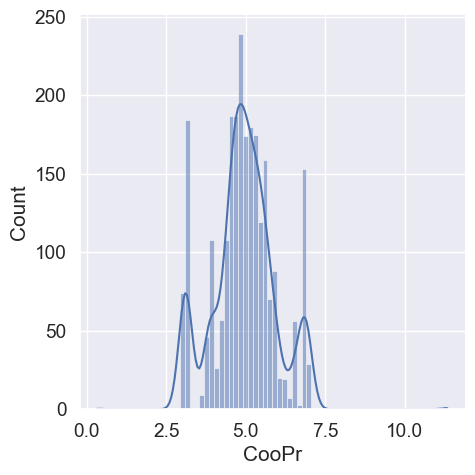

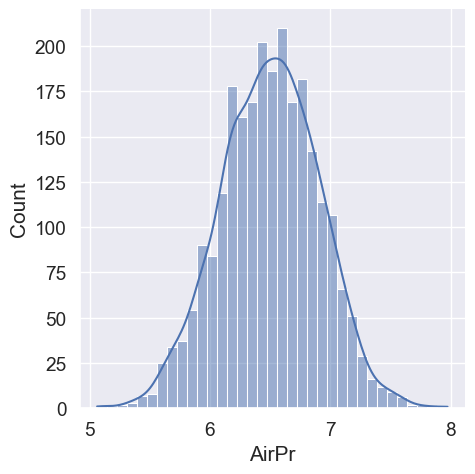

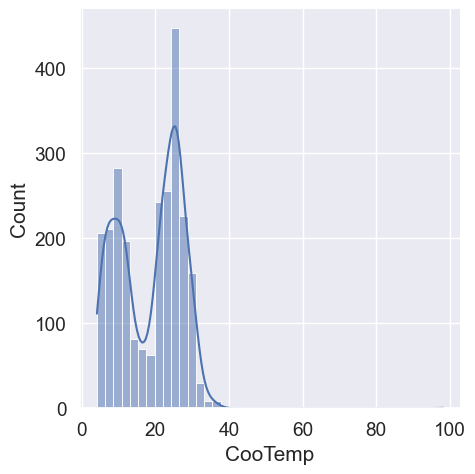

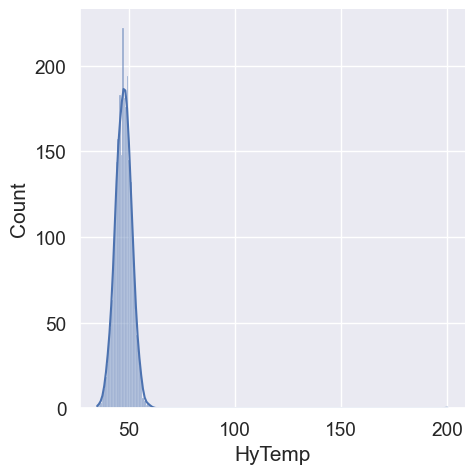

...

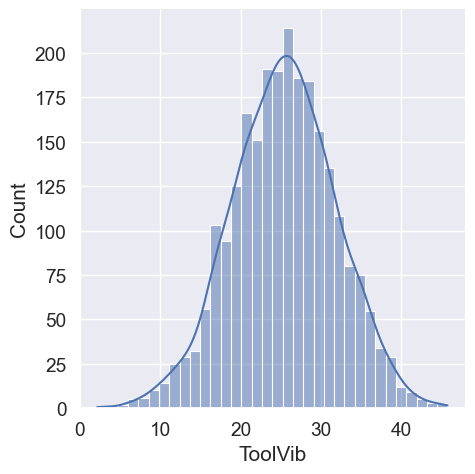

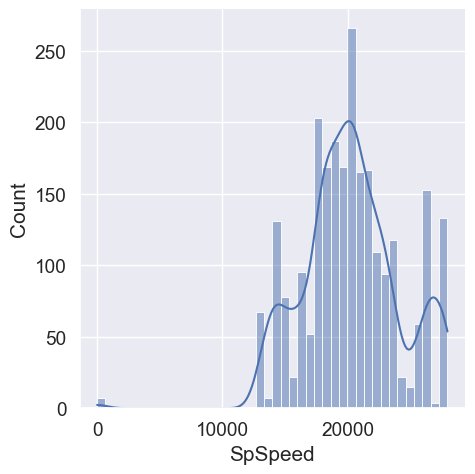

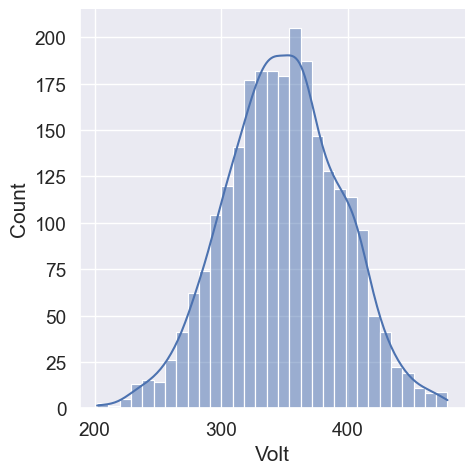

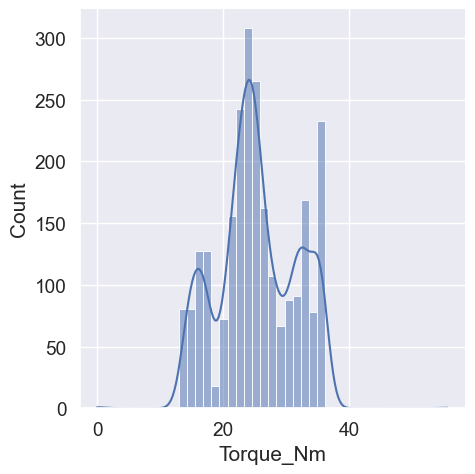

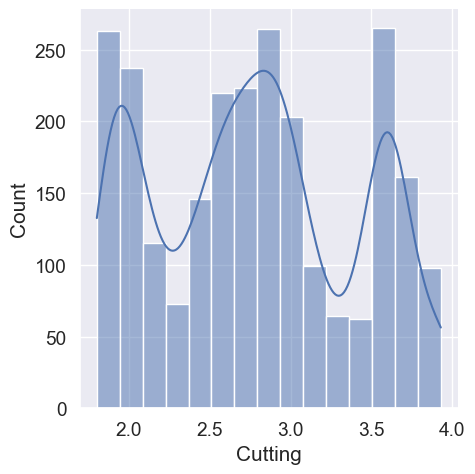

In [25]:
numerical_variables = ['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']
for y in numerical_variables:
    sns.displot(x=y, data=df, kde=True)
    plt.show()


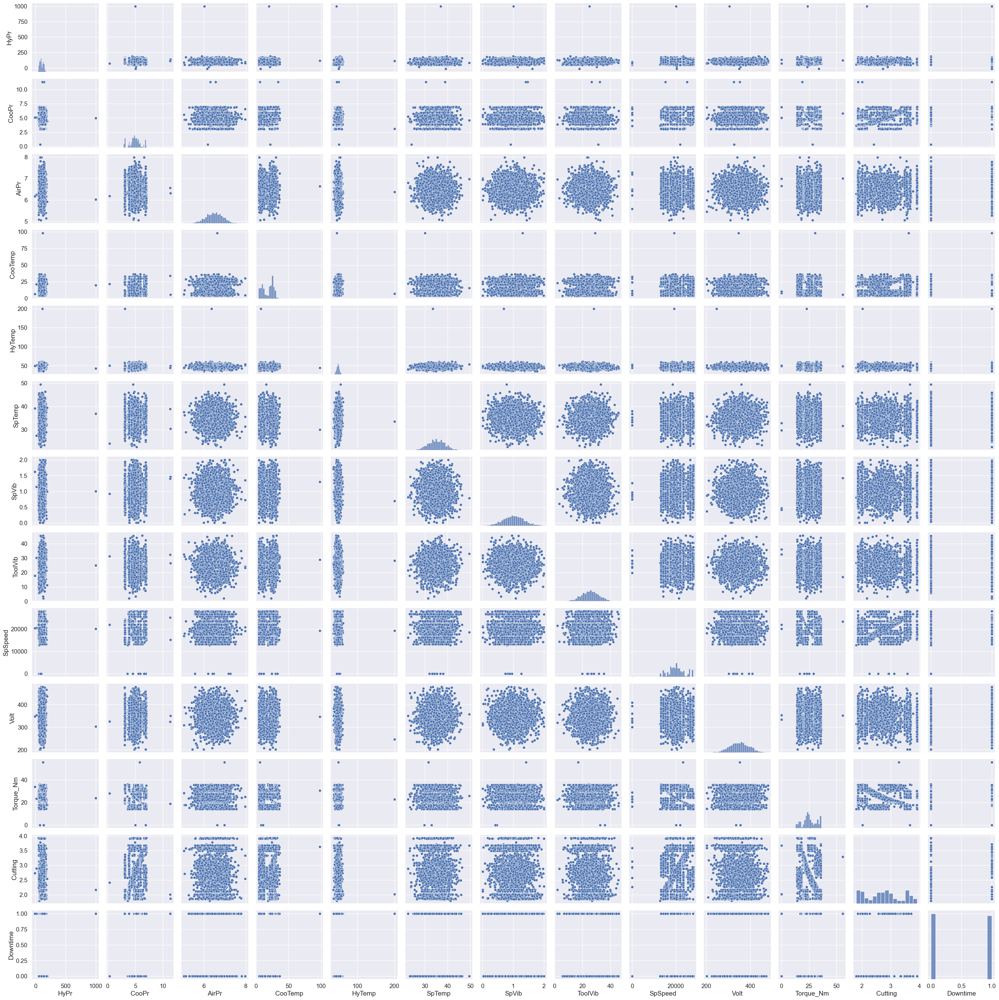

In [26]:
# Select the variables for bivariate analysis
variables = ['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting', 'Downtime']

# Create scatter plots
sns.pairplot(df[variables])  

In [27]:
df.head()

,Machine_ID,HyPr,CooPr,AirPr,CooTemp,HyTemp,SpTemp,SpVib,ToolVib,SpSpeed,Volt,Torque_Nm,Cutting,Downtime
0,Makino-L1-Unit1-2013,71.04,6.933725,6.284965,25.6,46.0,33.4,1.291,26.492,25892.0,335.0,24.055326,3.58,0
1,Makino-L1-Unit1-2013,NaN,4.936892,6.196733,35.3,47.4,34.6,1.382,25.274,19856.0,368.0,14.202890,2.68,0
2,Makino-L3-Unit1-2015,71.12,6.839413,6.655448,13.1,40.7,33.0,1.319,30.608,19851.0,325.0,24.049267,3.55,0
3,Makino-L2-Unit1-2015,139.34,4.574382,6.560394,24.4,44.2,40.6,0.618,30.791,18461.0,360.0,25.860029,3.55,0
4,Makino-L1-Unit1-2013,60.51,6.893182,6.141238,4.1,47.3,31.4,0.983,25.516,26526.0,354.0,25.515874,3.55,0


# Missing Values

In [28]:
df.isnull().sum()

Machine_ID     0
HyPr          11
CooPr         20
AirPr         19
CooTemp       12
HyTemp        17
SpTemp         9
SpVib         11
ToolVib       11
SpSpeed        8
Volt           6
Torque_Nm     26
Cutting        7
Downtime       0
dtype: int64

We find outliers using boxplot and IQR

In [29]:
num_feature= ['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib',
       'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']

Q1 = df[num_feature].quantile(0.25)
Q3 = df[num_feature].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = (df[num_feature] < lower_bound) | (df[num_feature] > upper_bound)

In [30]:
# Count the number of outliers in each column
num_outliers = outliers.sum()

# Display columns with outliers
columns_with_outliers = num_outliers[num_outliers > 0].index
print("Columns with outliers:", columns_with_outliers)

Columns with outliers: Index(['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp', 'SpVib',
       'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm'],
      dtype='object')


In [31]:
for col in columns_with_outliers:
    median_value = df[col].median()
    df[col].fillna(median_value, inplace=True)

In [32]:
df['Cutting'].fillna(df['Cutting'].mean(),inplace=True)

In [33]:
df.isnull().sum()

Machine_ID    0
HyPr          0
CooPr         0
AirPr         0
CooTemp       0
HyTemp        0
SpTemp        0
SpVib         0
ToolVib       0
SpSpeed       0
Volt          0
Torque_Nm     0
Cutting       0
Downtime      0
dtype: int64

In [34]:
df.head()

,Machine_ID,HyPr,CooPr,AirPr,CooTemp,HyTemp,SpTemp,SpVib,ToolVib,SpSpeed,Volt,Torque_Nm,Cutting,Downtime
0,Makino-L1-Unit1-2013,71.04,6.933725,6.284965,25.6,46.0,33.4,1.291,26.492,25892.0,335.0,24.055326,3.58,0
1,Makino-L1-Unit1-2013,96.69,4.936892,6.196733,35.3,47.4,34.6,1.382,25.274,19856.0,368.0,14.202890,2.68,0
2,Makino-L3-Unit1-2015,71.12,6.839413,6.655448,13.1,40.7,33.0,1.319,30.608,19851.0,325.0,24.049267,3.55,0
3,Makino-L2-Unit1-2015,139.34,4.574382,6.560394,24.4,44.2,40.6,0.618,30.791,18461.0,360.0,25.860029,3.55,0
4,Makino-L1-Unit1-2013,60.51,6.893182,6.141238,4.1,47.3,31.4,0.983,25.516,26526.0,354.0,25.515874,3.55,0


In [35]:
#We divide the data into df train and test
#later we will remove target variable
df_train, df_test = train_test_split(df, test_size=0.2, random_state=42)

In [36]:
def hist_df(row,col,df_tr,df_te):


    fig, axes = plt.subplots(row,col,figsize = (30,15))

    nu_col = 0
    fig.suptitle('Train vs Test Dist')
    for i in range(row):
        for c in range(col):
            sns.histplot(x = num_feature[nu_col],data = df_tr ,ax = axes[i][c],kde=True,label='Train')
            sns.histplot(x = num_feature[nu_col],data = df_te ,ax = axes[i][c],kde=True,label="Test")
            axes[i][c].legend()
            
            nu_col+=1
    plt.tight_layout()
    plt.show()
def stat_train_test(df_tr,df_te):
    fig, axs = plt.subplots(1,2,figsize = (25,10))

    fig.suptitle('Train Statitics vs Test Statitics')
    g = sns.heatmap(df_tr[num_feature].describe().transpose(), annot=True, cmap='YlOrBr', fmt=".0f", cbar=False,ax=axs[0])
    g.set_title('Train Statitics')
    g = sns.heatmap(df_te[num_feature].describe().transpose(), annot=True, cmap='YlOrBr', fmt=".0f", cbar=False,ax=axs[1])
    g.set_title('Test Statitics')

    plt.tight_layout()
    plt.show()
def stat_train_test_heat(df_tr,df_te):
    fig, axs = plt.subplots(1,2,figsize = (25,10))

    fig.suptitle('Train Statitics vs Test HeatMap')
    g = sns.heatmap(df_tr.corr(), annot=True, cmap='YlOrBr', fmt=".2f", cbar=False,ax=axs[0])
    g.set_title('Train HeatMap')
    g = sns.heatmap(df_te.drop('Machine_ID',axis = 1).corr(), annot=True, cmap='YlOrBr', fmt=".2f", cbar=False,ax=axs[1])
    g.set_title('Test HeatMap')

    plt.tight_layout()
    plt.show()

In [37]:
print(df.columns)

Index(['Machine_ID', 'HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting',
       'Downtime'],
      dtype='object')


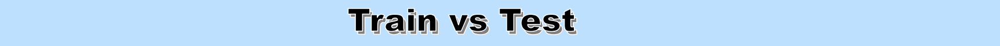

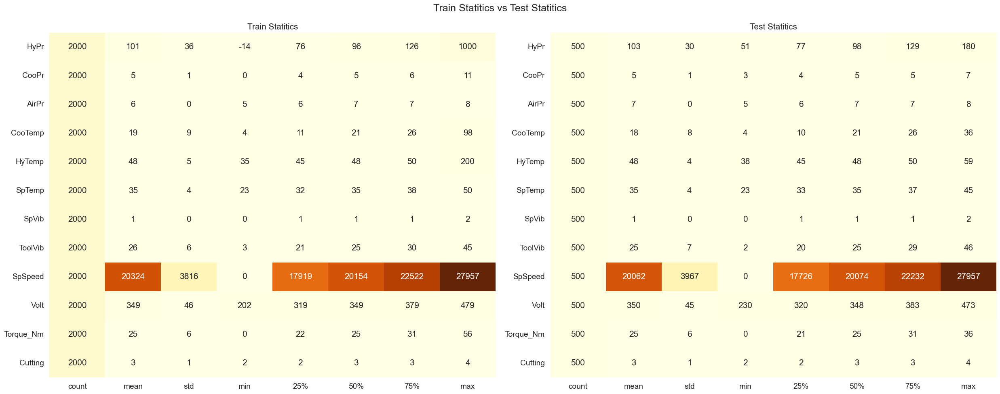

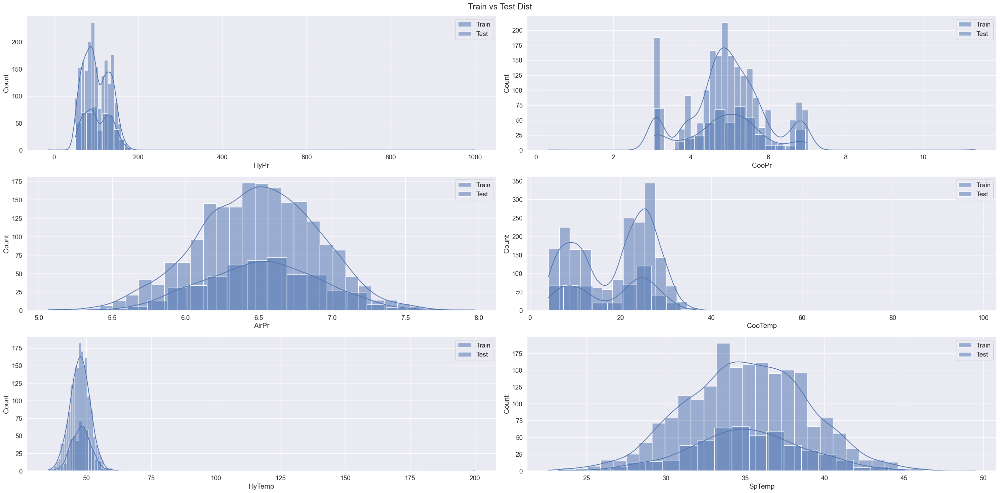

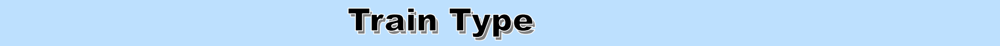

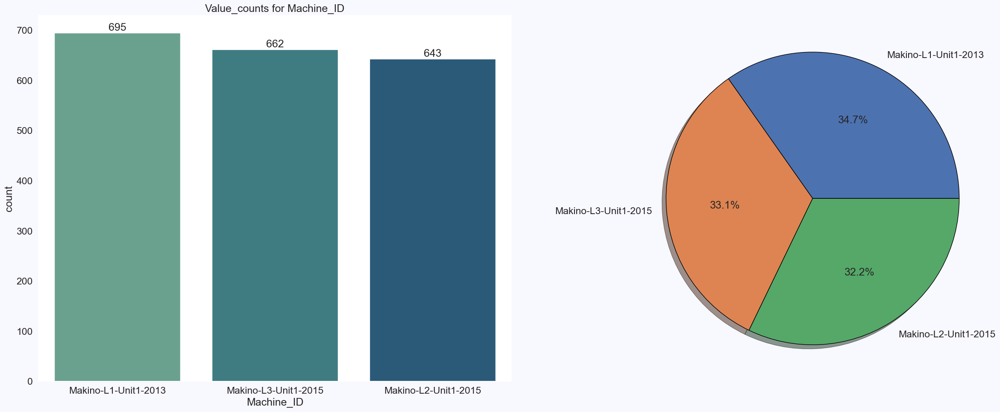

...

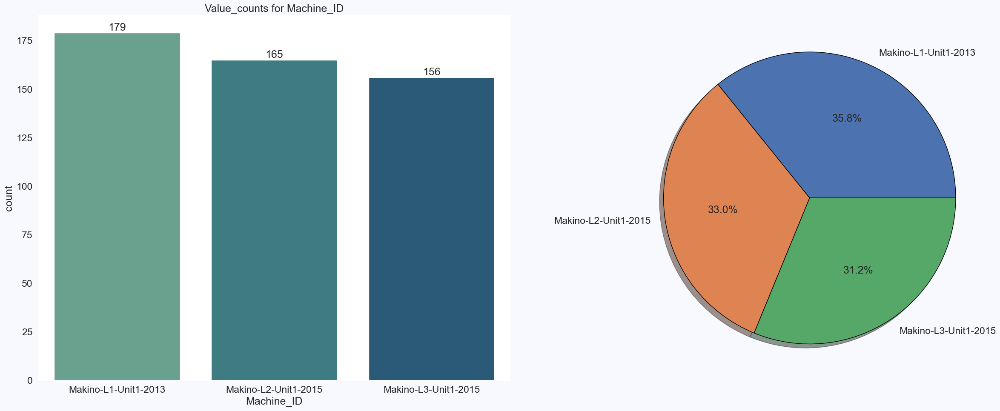

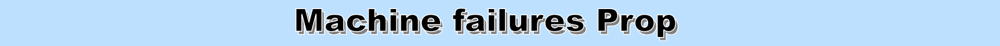

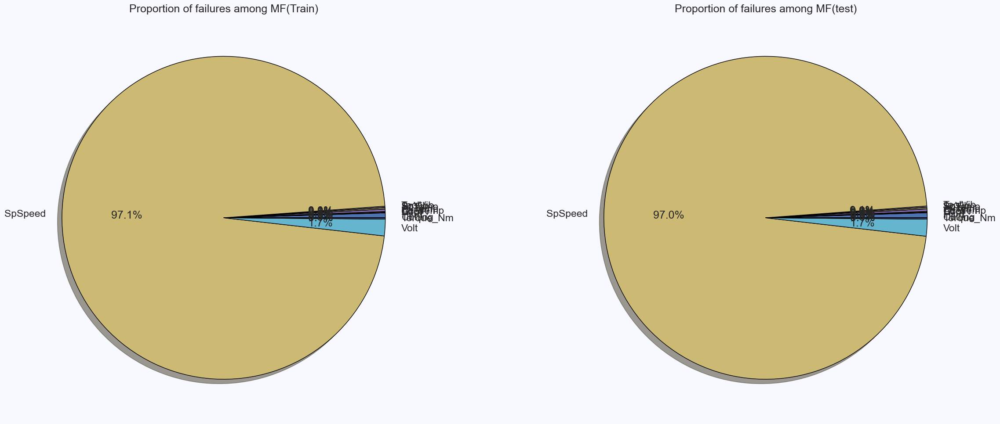

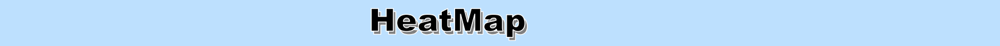

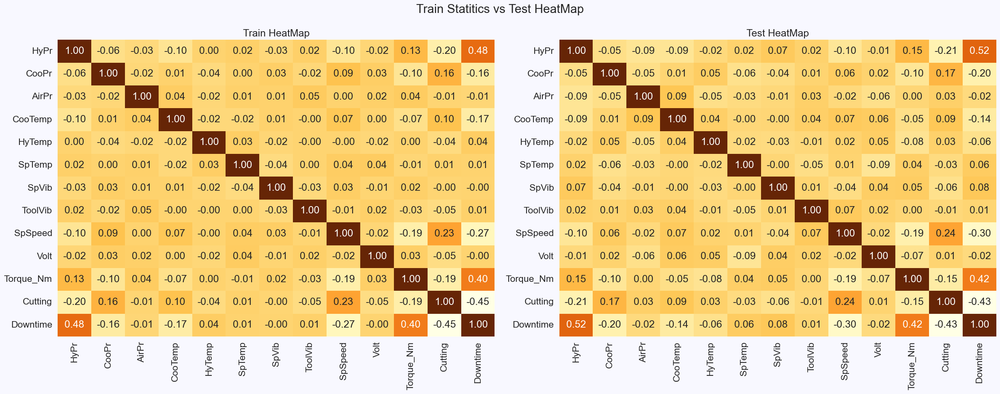

In [38]:
label_txt(f'                  Train vs Test',w = 0.15)
stat_train_test(df_train,df_test)
hist_df(3,2,df_train,df_test)

label_txt(f'                  Train Type',w = 0.15)

cat_ana('Machine_ID',df_train)

fig, axes = plt.subplots(1,2,figsize = (25,10))

axes[0].pie(df_train.groupby('Machine_ID')[['Downtime']].aggregate('sum')['Downtime'].values , labels =df_train.groupby('Machine_ID')[['Downtime']].aggregate('sum')['Downtime'].index 
            , shadow = True , autopct= '%1.1f%%', wedgeprops= {'edgecolor' : 'black'} )

axes[0].set_title('Machine failure count by Type')

sns.barplot(x = 'Machine_ID',y = 'Downtime',data = df_train,estimator=np.mean,ci = None ,ax = axes[1])
axes[1].set_title('Machine failure Mean by Type')




label_txt(f'                  Test Type ',w = 0.15)
cat_ana('Machine_ID',df_test)






label_txt(f'             Machine failures Prop ',w = 0.15)
fig, axes = plt.subplots(1,2,figsize = (25,10))

axes[0].pie(df_train[['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']].sum() , labels =df_train[['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']].sum().index 
            , shadow = True , autopct= '%1.1f%%', wedgeprops= {'edgecolor' : 'black'} )
axes[0].set_title('Proportion of failures among MF(Train)')

axes[1].pie(df_test[['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']].sum() , labels =df_train[['HyPr', 'CooPr', 'AirPr', 'CooTemp', 'HyTemp', 'SpTemp',
       'SpVib', 'ToolVib', 'SpSpeed', 'Volt', 'Torque_Nm', 'Cutting']].sum().index 
            , shadow = True , autopct= '%1.1f%%', wedgeprops= {'edgecolor' : 'black'} )
axes[1].set_title('Proportion of failures among MF(test)')

plt.tight_layout()
plt.show()

label_txt(f'                    HeatMap ',w = 0.15)

stat_train_test_heat(df_train,df_test)

In [39]:
df_train = df_train.drop('Machine_ID', axis=1)
df_test = df_test.drop('Machine_ID', axis=1)

In [40]:
df_train.head()

,HyPr,CooPr,AirPr,CooTemp,HyTemp,SpTemp,SpVib,ToolVib,SpSpeed,Volt,Torque_Nm,Cutting,Downtime
2055,131.663001,3.164805,6.140425,11.9,47.1,30.3,1.133,19.481,15217.0,358.0,35.580334,2.65,1
1961,71.466020,5.039570,6.360325,20.6,45.0,31.5,1.150,22.998,17726.0,355.0,32.370456,1.89,1
1864,141.140000,6.560332,7.026780,32.6,49.5,30.8,1.261,38.348,26526.0,344.0,16.449554,2.28,0
2326,64.940000,6.893182,6.684550,24.4,48.6,39.2,0.822,27.063,19860.0,431.0,24.038369,3.58,0
461,109.379500,5.276748,6.996745,22.9,52.4,39.8,0.565,19.495,21210.0,387.0,22.508345,2.77,1


In [41]:
# Define X and y
X_train = df_train.drop(columns=['Downtime'])
y_train = df_train['Downtime']

X_test = df_test.drop(columns=['Downtime'])
y_test = df_test['Downtime']

In [42]:
from xgboost import XGBClassifier# XGBoost
from lightgbm import LGBMClassifier
import lightgbm as lgb  # LightGBM
from sklearn.ensemble import AdaBoostClassifier,BaggingClassifier,ExtraTreesClassifier,GradientBoostingClassifier,HistGradientBoostingClassifier,RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from catboost import CatBoostClassifier
model_dict = {
    
    'RandomForestClassifier': RandomForestClassifier(
    
    ),
    
    
    'LogisticRegression':LogisticRegression(
        max_iter=1000
    ),
    
    
    'AdaBoostClassifier': AdaBoostClassifier(
    
    ),
    'BaggingClassifier': BaggingClassifier (
    
    ),
    
    'ExtraTreesClassifier' : ExtraTreesClassifier(
    
    ),
    
    'GradientBoostingClassifier' : GradientBoostingClassifier(
    
    ),
    
    
    'XGBClassifier': XGBClassifier(
                silent=True

    )
}

In [43]:
from sklearn.metrics import roc_auc_score,roc_curve

model_name = []
model_cv = []
model_roc = []

model_ypred_prop = []
model_ypred = []


for i in model_dict:
    
    model = model_dict[i]
    
    scores = cross_val_score(model,X_train,y_train,cv = 4)
    print(f'{i} Avg_Cv Score is  {np.mean(scores)}')
    
    
    model.fit(X_train,y_train)
    
    
    
    model_name.append(i)
    model_cv.append(np.mean(scores))
    
    
    y_pred_prop = model.predict_proba(X_test)[:,1]
    y_pred = model.predict(X_test)
    
    
    model_ypred_prop.append(y_pred_prop)
    model_ypred.append(y_pred)
    
    model_roc.append(roc_auc_score(y_test,y_pred_prop))
    
    print('-' * 30)

RandomForestClassifier Avg_Cv Score is  0.9804999999999999
------------------------------
LogisticRegression Avg_Cv Score is  0.85
------------------------------
AdaBoostClassifier Avg_Cv Score is  0.989
------------------------------
BaggingClassifier Avg_Cv Score is  0.9595
------------------------------
ExtraTreesClassifier Avg_Cv Score is  0.9829999999999999
------------------------------
GradientBoostingClassifier Avg_Cv Score is  0.9895
------------------------------
[22:09:53] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[22:09:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "silent" } are not used.

[22:09:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-win

In [44]:
dict_model_info = {
    'CV Score':model_cv,
    'ROC':model_roc
    
}

df_model_eva = pd.DataFrame(dict_model_info ,index = model_name)
df_model_eva.sort_values(['CV Score','ROC'],axis = 0,ascending = False)

,CV Score,ROC
XGBClassifier,0.9895,0.999518
GradientBoostingClassifier,0.9895,0.999405
AdaBoostClassifier,0.9890,0.996206
ExtraTreesClassifier,0.9830,0.999711
RandomForestClassifier,0.9805,0.999124
BaggingClassifier,0.9595,0.993948
LogisticRegression,0.8500,0.917153


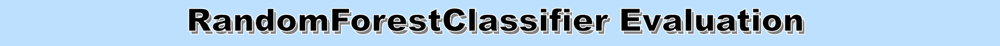

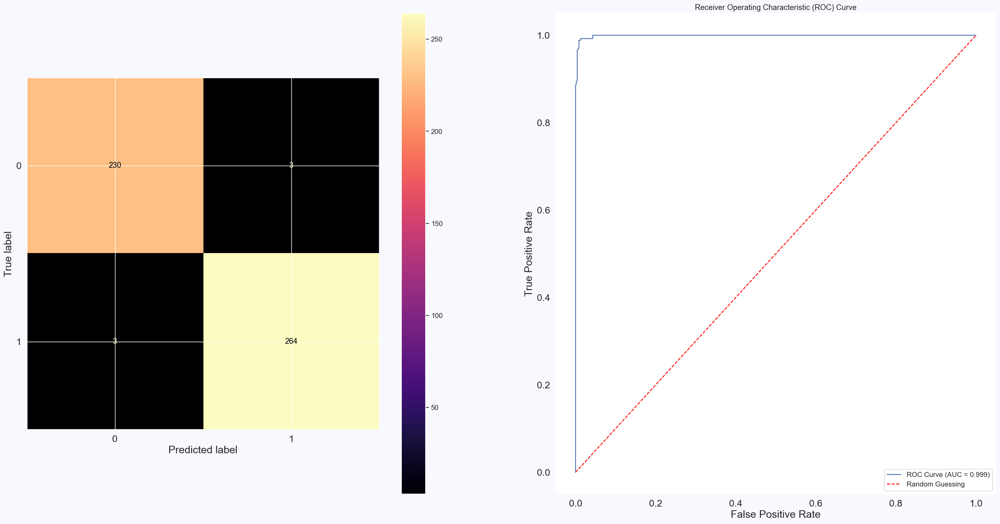

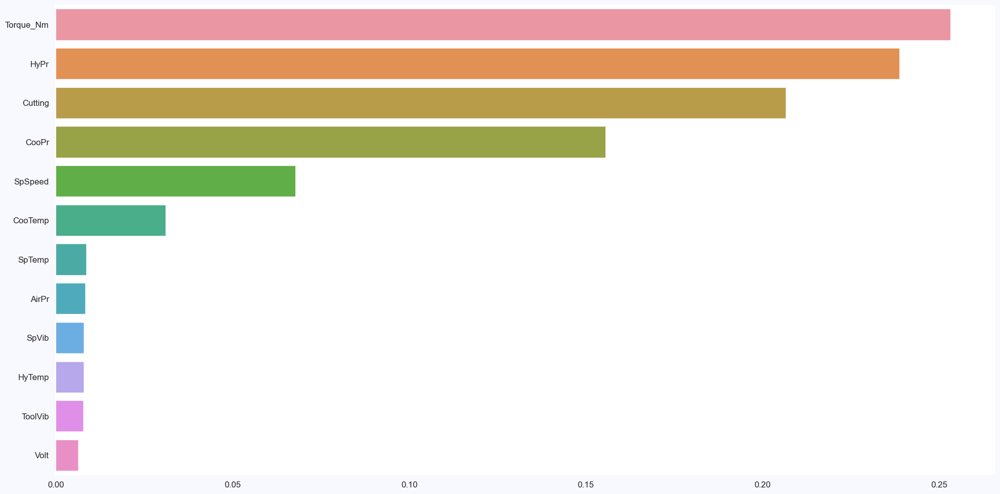

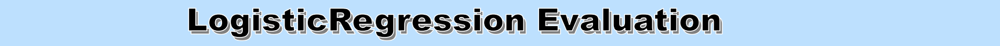

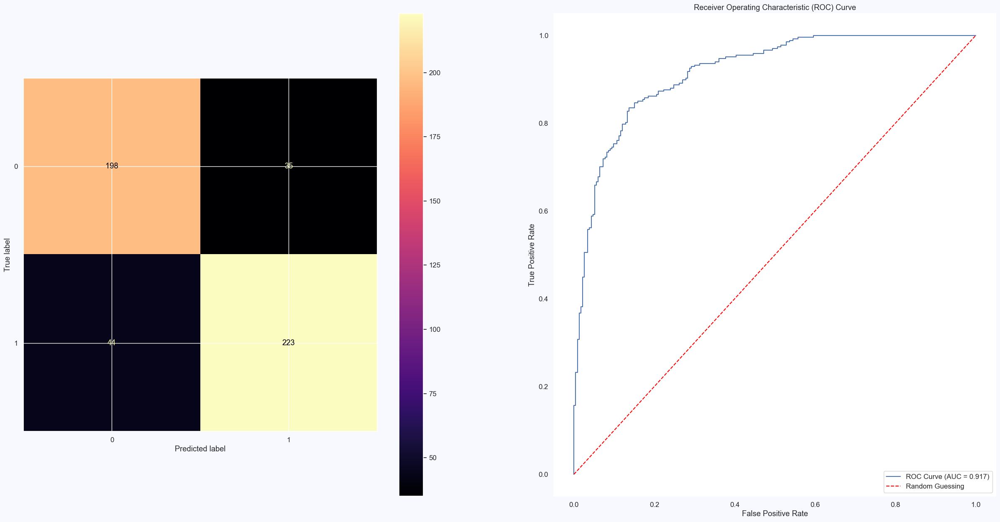

...

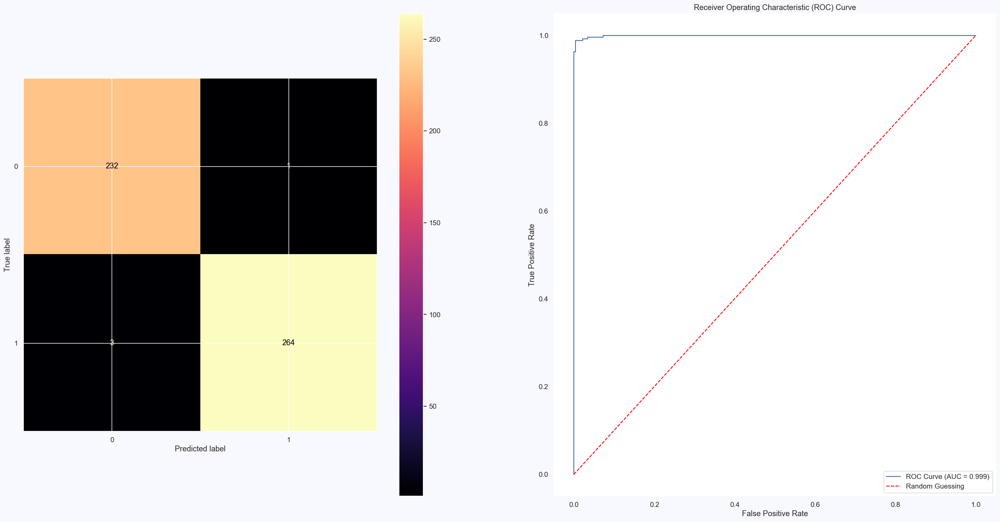

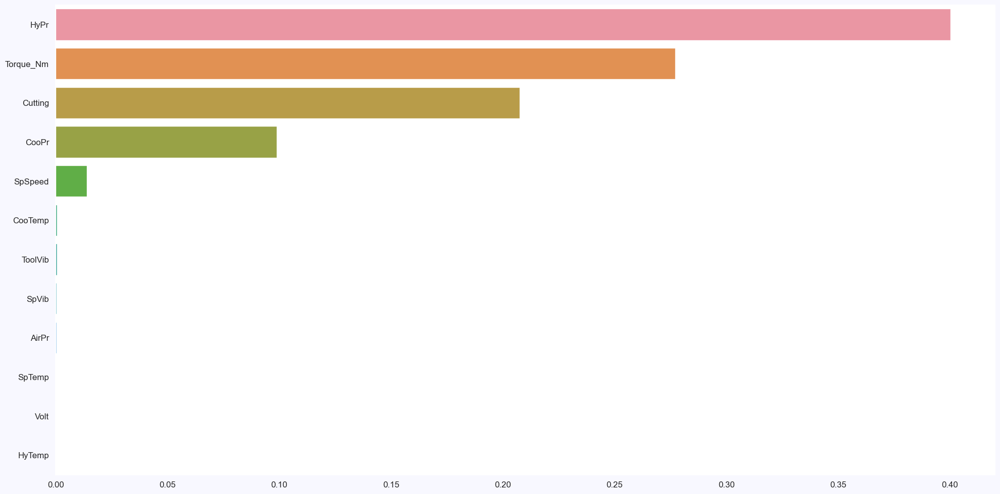

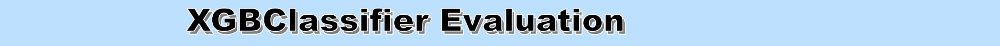

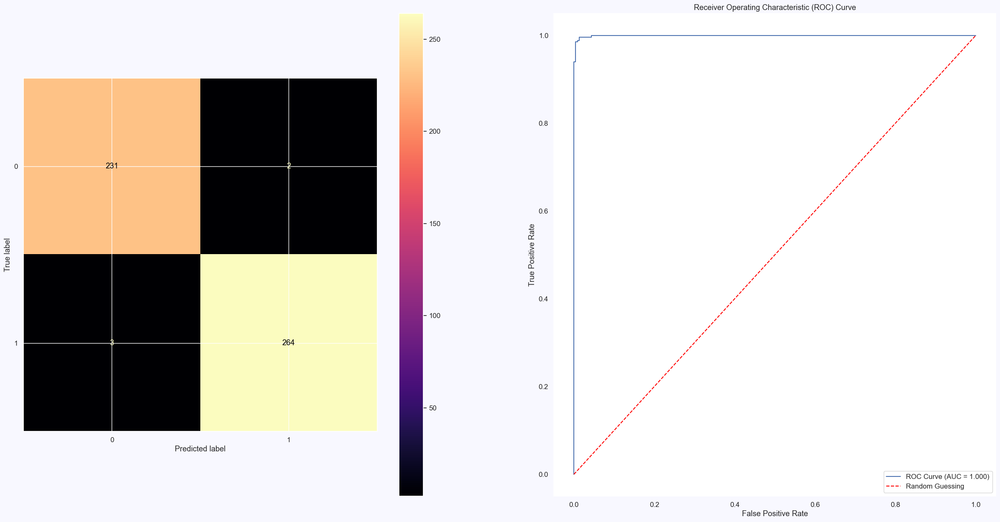

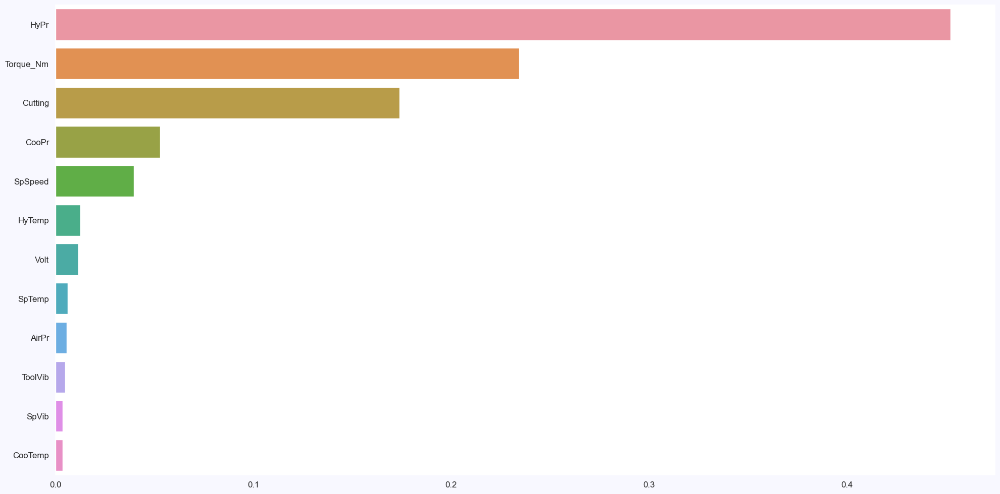

In [45]:
from sklearn.metrics import ConfusionMatrixDisplay,confusion_matrix
for i in range(len(list(model_dict))):
    
    label_txt(f'   {list(model_dict)[i]} Evaluation',w = 0.15)

    fig, axes = plt.subplots(1, 2, figsize = (30, 15),dpi = 100)
    
    sns.set_context('notebook',font_scale= 1.1)
    plt.rcParams['figure.facecolor'] = 'ghostwhite'
    plt.rcParams['axes.facecolor'] = 'white'
    g = ConfusionMatrixDisplay(confusion_matrix(y_test,model_ypred[i])).plot(cmap='magma',ax = axes[0])

    fpr, tpr, thresholds = roc_curve(y_test,model_ypred_prop[i])
    auc_score = roc_auc_score(y_test,model_ypred_prop[i])


    axes[1].plot(fpr, tpr, label=f'ROC Curve (AUC = {auc_score:.3f})', color='b')
    axes[1].plot([0, 1], [0, 1], '--', color='red', label='Random Guessing')

    axes[1].set_xlabel('False Positive Rate')
    axes[1].set_ylabel('True Positive Rate')

    axes[1].set_title('Receiver Operating Characteristic (ROC) Curve')
    axes[1].legend(loc='lower right')
    axes[1].grid(True)
    axes[1].patch.set_linewidth(10)
    if list(model_dict)[i] in ['BaggingClassifier','LogisticRegression','HistGradientBoostingClassifier']:
        continue
        
        
    plt.figure(figsize=(20,10))

    sns.barplot(y =X_train.columns, x =  model_dict[list(model_dict)[i]].feature_importances_, 
            order=X_train.columns[np.argsort(-model_dict[list(model_dict)[i]].feature_importances_)])

    plt.tight_layout()

In [46]:
# Close the connection
conn.close()
